<a href="https://colab.research.google.com/github/akimi-yano/Vehicle_Registration_Plate_Object_Detection/blob/main/Vehicle_Registration_Plate_Object_Detection_PyTorch.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# <font style="color:blue">Vehicle Registration Plate Object Detection Project</font>

In [ ]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 949.8/949.8 kB 22.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 91.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 73.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 52.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 37.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 17.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 4.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 91.1 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstal

In [ ]:
import os
import requests
from zipfile import ZipFile
import glob
import re
import shutil as sh
import yaml
from IPython.display import FileLink

import cv2
from PIL import Image
import random
import numpy as np

import matplotlib.pyplot as plt

import albumentations as A
from albumentations.pytorch.transforms import ToTensorV2

import torch
from torch.utils.data import Dataset, DataLoader

from torchvision.io import read_image
from torchvision.utils import draw_bounding_boxes

from ultralytics import YOLO

%matplotlib inline

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


# <font style="color:purple">Download the Dataset</font>

**[Download the Vehicle registration plate](https://www.dropbox.com/s/k81ljpmzy3fgtx9/Dataset.zip?dl=1)**


Download the Vehicle Registration Plate dataset from [here](https://www.dropbox.com/s/k81ljpmzy3fgtx9/Dataset.zip?dl=1) and unzip it.

The directory structure:

```
Dataset
├── train
│   └── Vehicle registration plate
│       └── Label
└── validation
    └── Vehicle registration plate
        └── Label
```

Unzipping the file will give a directory `Dataset`. This directory has two folder `train` and `validation`. Each train and validation folder has `Vehicle registration plate`  folder with `.jpg` images and a folder `Labels`.  `Labels` folder has bounding box data for the images.


For example,
For image: `Dataset/train/Vehicle registration plate/bf4689922cdfd532.jpg`
Label file is  `Dataset/train/Vehicle registration plate/Label/bf4689922cdfd532.txt`

There are one or more lines in each `.txt` file. Each line represents one bounding box.
For example,
```
Vehicle registration plate 385.28 445.15 618.24 514.225
Vehicle registration plate 839.68 266.066462 874.24 289.091462
```

This is a single class detection (`Vehicle registration plate detection`) problem. So bounding box details start from the fourth column in each row.

Representation is in `xmin`, `ymin`, `xmax`, and `ymax` format.

**It has `5308` training and `386` validation dataset.**

Data is downloaded from [Open Images Dataset](https://storage.googleapis.com/openimages/web/index.html)

In [ ]:
def download_file(url, save_name):
    """
    "Download and save the file."

    arguments:
    url (str): URL path of the file.
    save_name: (str): file path to save the downloaded file.
    """
    file = requests.get(url)
    open(save_name, 'wb').write(file.content)
    print(f"Downloaded {save_name}")

In [ ]:
def unzip(zip_file_path=None):
    """
    "Unzip the file"

    arguments:
    zip_file_path (str): The zipped file path

    """
    try:
        with ZipFile(zip_file_path) as z:
            z.extractall("./")
            print(f"Extracted {zip_file_path}\n")
    except:
        print("Invalid file")

In [ ]:
if not os.path.exists('Dataset'):
    download_file(
                  'https://www.dropbox.com/s/k81ljpmzy3fgtx9/Dataset.zip?dl=1',
                  'Dataset.zip'
                 )

    unzip('Dataset.zip')

Downloaded Dataset.zip
Extracted Dataset.zip



In [ ]:
root_dir = '/content/Dataset'
for elem in os.walk(root_dir):
  print(elem)

('/content/Dataset', ['validation', 'train'], [])
('/content/Dataset/validation', ['Vehicle registration plate'], [])
('/content/Dataset/validation/Vehicle registration plate', ['Label'], ['6c144e47161867c2.jpg', '88df55ff4e13b90d.jpg', '5a3f94aa35766f31.jpg', '1a3e9d87d733ff7f.jpg', 'e1120bfe48f85c1b.jpg', '26183d88c4f8012f.jpg', 'f1131b93a33cefb9.jpg', '6e819dc674a74078.jpg', '844adfe06e003c09.jpg', '7b4e86e1c94d65de.jpg', 'f9f539977bfea25e.jpg', '647ff22cf6950211.jpg', '0fbd1b85fc01d2ae.jpg', 'd830c3573e57bfc0.jpg', '593e594137f374ab.jpg', 'defd8f4b30b3e1e1.jpg', 'e2427db217e5c3db.jpg', '90596bf3313e72e3.jpg', 'b25d7d2cb7abf86b.jpg', 'ccc1a2d44a290368.jpg', 'f53243c2bb551b8a.jpg', '4b3aba5dfb7a0492.jpg', '77e716224c85410f.jpg', '2e95d7a799e23e11.jpg', '944281d0485869f0.jpg', 'fe6139d150a3e2a8.jpg', 'f3814f4a6121838d.jpg', 'fb55b73f241bf50a.jpg', '28e26a4eb646c67a.jpg', '54bd93e5a4de808a.jpg', '49595029959689b7.jpg', '0d6ca8553971fefd.jpg', 'b7cdb5c0c99002b7.jpg', '895d440e05b2a8d8.j

In [ ]:
train_image_path = os.path.join(root_dir, 'train/Vehicle registration plate/')
train_label_path = os.path.join(root_dir, 'train/Vehicle registration plate/Label/')
validation_image_path = os.path.join(root_dir, 'validation/Vehicle registration plate/')
validation_label_path = os.path.join(root_dir, 'validation/Vehicle registration plate/Label/')

#  <font style="color:green">1. Plot Ground Truth Bounding Boxes</font>

In [ ]:
def plot_image(image, bboxes, labels):
    h, w, _ = image.shape
    thickness = max(2, int(w/275))
    for box_num, box in enumerate(bboxes):
        x1, y1, x2, y2 = box
        x1, y1, x2, y2 = int(x1), int(y1), int(x2), int(y2)
        cv2.rectangle(image, (x1, y1), (x2, y2), (0, 200, 0), thickness)

        (text_width, text_height), baseline = cv2.getTextSize('Reg-plate', cv2.FONT_HERSHEY_SIMPLEX, 0.6, 2)
        cv2.rectangle(image, (x1, y1 - text_height - 5), (x1 + text_width, y1), (0, 0, 0), -1)
        cv2.putText(image, 'Reg-plate', org = (x1,y1-5),
                    fontFace = cv2.FONT_HERSHEY_SIMPLEX,
                    fontScale = 0.6,
                    color = (0, 200, 0),
                    thickness = 1,
                    lineType = cv2.LINE_AA)
    return image

In [ ]:
def display_plotted_image(label_path, image_path, num_samples):
    all_images = glob.glob(image_path +'*.jpg')
    all_images.sort()
    num_images = len(all_images)

    for i in range(num_samples):
        j = random.randint(0, num_images-1)
        image = all_images[j]
        image_name = ('.'.join(image.split(os.path.sep)[-1].split('.')[:-1]))
        image = cv2.imread(image)
        label_file_path = label_path + image_name +'.txt'
        pattern = r'^Vehicle registration plate'
        label_len = len(pattern) - 1
        bboxes = []
        labels = []
        with open(label_file_path,'r') as f:
            label_lines = f.readlines()
            plt.figure(figsize=(20, 20))
            for label_line in label_lines:
                label = re.match(pattern, label_line).group()
                xmin, ymin, xmax, ymax = label_line[label_len:].split()
                xmin = float(xmin)
                ymin = float(ymin)
                xmax = float(xmax)
                ymax = float(ymax)

                bboxes.append([xmin,ymin,xmax,ymax])
                labels.append(label)

        result_image = plot_image(image, bboxes, labels)
        plt.subplot(3, 1, i+1)
        plt.imshow(result_image[:, :, ::-1])

    plt.subplots_adjust(wspace=1)
    plt.tight_layout()
    plt.show()

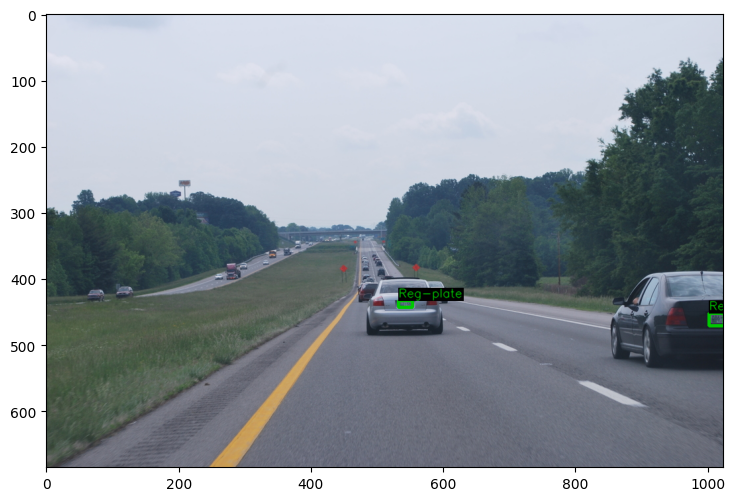

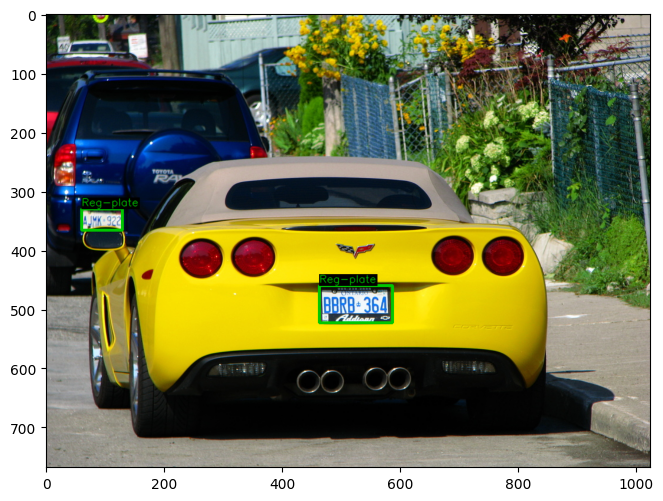

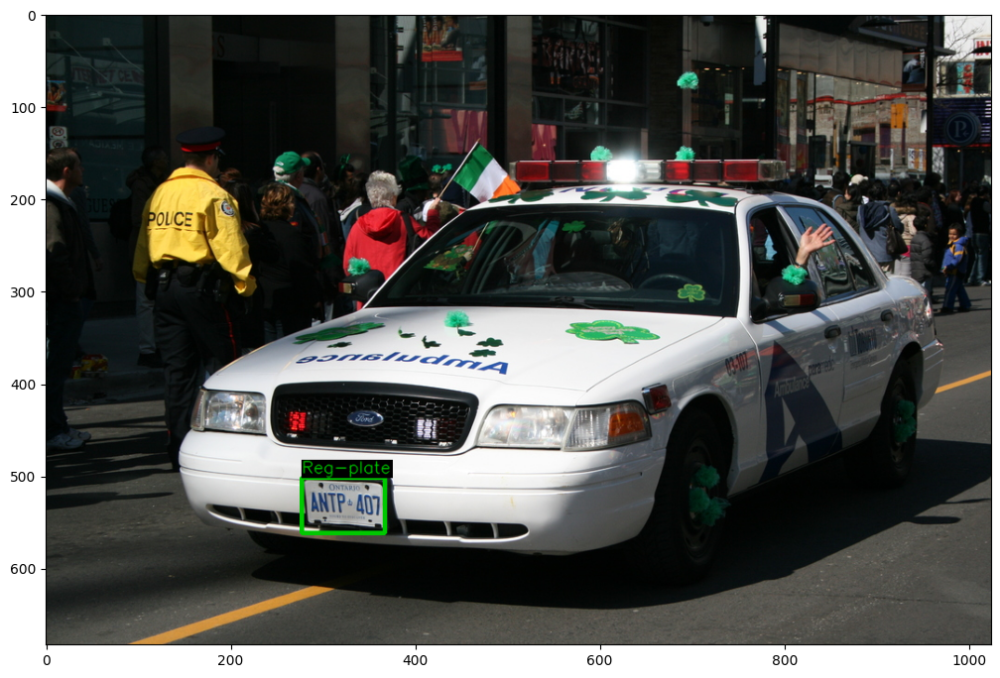

In [ ]:
display_plotted_image(validation_label_path, validation_image_path, 3)

#  <font style="color:green">2. Training</font>

In [ ]:
class_names = {
    "Vehicle registration plate" : 0
}

In [ ]:
def convert_to_yolo_format(xmin, ymin, xmax, ymax, img_height,img_width,count ):
    x_center,y_center,width,height = 0,0,0,0

    x_center = xmin + ((xmax-xmin)/2)
    y_center = ymin + ((ymax-ymin)/2)
    width = xmax - xmin
    height = ymax - ymin
    #Normalize
    x_center = x_center/img_width
    y_center = y_center/img_height
    width = width/img_width
    height = height/img_height
    return x_center,y_center,width,height

In [ ]:
def get_bbox_cord(label_path, image_path):
    all_images =[]
    all_images.extend(glob.glob(image_path +'*.jpg'))
    all_images.extend(glob.glob(image_path +'*.JPG'))

    all_images.sort()
    num_images = len(all_images)

    bboxes = []
    labels = []
    image_names = []
    sum = 0

    pattern = r'^Vehicle registration plate'
    count = 0
    for id,image in enumerate(all_images):

        bboxes_per_image = []
        labels_per_image = []

        image_name = ('.'.join(image.split(os.path.sep)[-1].split('.')[:-1]))
        image_names.append(image_name)

        image = cv2.imread(image)
        height,width,_ = image.shape

        label_file_path = label_path + image_name +'.txt'
        with open(label_file_path,'r') as f:
            label_lines = f.readlines()
            sum+=len(label_lines)  #total num of labels

            for label_line in label_lines:
                #Labels
                label = re.match(pattern, label_line).group()
                label_len = len(label)
                label = class_names[label]
                labels_per_image.append([int(label)])
                #Bounding box
                xmin, ymin, xmax, ymax = label_line[label_len:].split()
                xmin = float(xmin)
                xmax = float(xmax)
                ymin = float(ymin)
                ymax = float(ymax)

                #convert to YOLO format
                x_center, y_center,width_n,height_n = convert_to_yolo_format(xmin, ymin, xmax, ymax,height,width,count)

                bboxes_per_image.append([x_center, y_center,width_n,height_n])

        bboxes.append(bboxes_per_image)
        labels.append(labels_per_image)

    return labels,bboxes,all_images,image_names

In [ ]:
# Train Data
train_labels, train_bboxes, train_all_images, train_image_names = get_bbox_cord(train_label_path, train_image_path)

In [ ]:
print(len(train_labels))
print(len(train_bboxes))
print(len(train_all_images))
print(len(train_image_names))

5308
5308
5308
5308


In [ ]:
# Validation Data
validation_labels, validation_bboxes, validation_all_images, validation_image_names = get_bbox_cord(validation_label_path, validation_image_path)

In [ ]:
print(len(validation_labels))
print(len(validation_bboxes))
print(len(validation_all_images))
print(len(validation_image_names))

386
386
386
386


In [ ]:
# Make directories for YOLO
if not os.path.exists(os.path.join(root_dir, 'Vehicle_Registration_Plate')):
    os.makedirs(os.path.join(root_dir, 'Vehicle_Registration_Plate'))

    os.makedirs('/content/Dataset/Vehicle_Registration_Plate/train')
    os.makedirs('/content/Dataset/Vehicle_Registration_Plate/train/images')
    os.makedirs('/content/Dataset/Vehicle_Registration_Plate/train/labels')

    os.makedirs('/content/Dataset/Vehicle_Registration_Plate/validation')
    os.makedirs('/content/Dataset/Vehicle_Registration_Plate/validation/images')
    os.makedirs('/content/Dataset/Vehicle_Registration_Plate/validation/labels')

In [ ]:
# Train Data
for id, image_name in enumerate(train_image_names):
    image_path = train_all_images[id]
    name = ('.'.join(image_path.split(os.path.sep)[-1].split('.')[:-1]))
    if image_name == name:
        source = train_all_images[id]
        dest = '/content/Dataset/Vehicle_Registration_Plate/train/images/{}.jpg'.format(name)
        sh.copy(source,dest)
        filepath = '/content/Dataset/Vehicle_Registration_Plate/train/labels/{}.txt'.format(name)
        with open(filepath,'w+') as f:
            label = np.concatenate((train_labels[id],train_bboxes[id]),axis = 1)
            label = label.astype(str)
            for row in label:
                txt = ' '.join(row)
                f.write(txt)
                f.write('\n')

In [ ]:
# Validation Data
for id, image_name in enumerate(validation_image_names):
    image_path = validation_all_images[id]
    name = ('.'.join(image_path.split(os.path.sep)[-1].split('.')[:-1]))
    if image_name == name:
        source = validation_all_images[id]
        dest = '/content/Dataset/Vehicle_Registration_Plate/validation/images/{}.jpg'.format(name)
        sh.copy(source,dest)
        filepath = '/content/Dataset/Vehicle_Registration_Plate/validation/labels/{}.txt'.format(name)
        with open(filepath,'w+') as f:
            label = np.concatenate((validation_labels[id], validation_bboxes[id]),axis = 1)
            label = label.astype(str)
            for row in label:
                txt = ' '.join(row)
                f.write(txt)
                f.write('\n')

In [ ]:
# Function to convert bounding boxes in YOLO format to xmin, ymin, xmax, ymax.
def yolo2bbox(bboxes):
    xmin, ymin = bboxes[0]-bboxes[2]/2, bboxes[1]-bboxes[3]/2
    xmax, ymax = bboxes[0]+bboxes[2]/2, bboxes[1]+bboxes[3]/2
    return xmin, ymin, xmax, ymax

In [ ]:
def display_images(label_path, image_path, num_samples):

    all_images = glob.glob(image_path +'*.jpg')
    all_images.sort()
    num_images = len(all_images)

    for i in range(num_samples):
        print(num_images)
        j = random.randint(0, num_images-1)
        image = all_images[j]
        image_name = ('.'.join(image.split(os.path.sep)[-1].split('.')[:-1]))
        image = cv2.imread(image)
        height,width,_ = image.shape
        label_file_path = label_path + image_name +'.txt'
        # Regular expression pattern to match the label
        pattern = r'^Vehicle registration plate'
        label_len = len(pattern) - 1
        bboxes = []
        bboxes_c = []
        labels = []
        with open(label_file_path,'r') as f:
            label_lines = f.readlines()
            print(len(label_lines))
            plt.figure(figsize=(20, 20))
            for label_line in label_lines:
                # Extract label using regular expression
                label = re.match(pattern, label_line).group()
                x_c, y_c, w, h = label_line[label_len:].split()
                x_c = float(x_c)
                y_c = float(y_c)
                w = float(w)
                h = float(h)
                bboxes_c.append([x_c,y_c,w,h])

                for box_num, box in enumerate(bboxes_c):
                    xmin,ymin,xmax,ymax = yolo2bbox(box)
                    # denormalize
                    xmin = xmin*width
                    ymin = ymin*height
                    xmax = xmax*width
                    ymax = ymax*height
                    bboxes.append([xmin,ymin,xmax,ymax])
                labels.append(label)
        result_image = plot_image(image,bboxes,labels)
        plt.subplot(3, 1, i+1)
        plt.imshow(result_image[:, :, ::-1])

    plt.subplots_adjust(wspace=1)
    plt.tight_layout()
    plt.show()

386
2
386
1
386
1


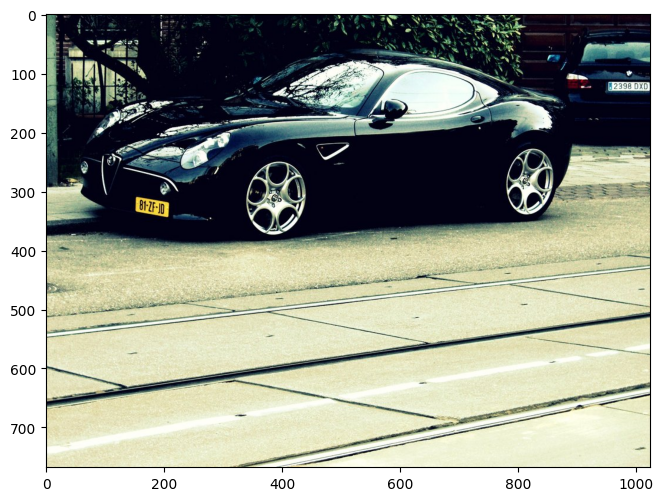

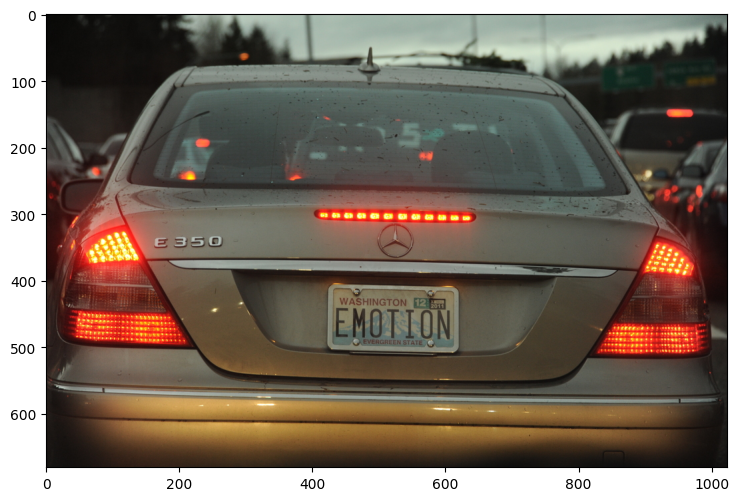

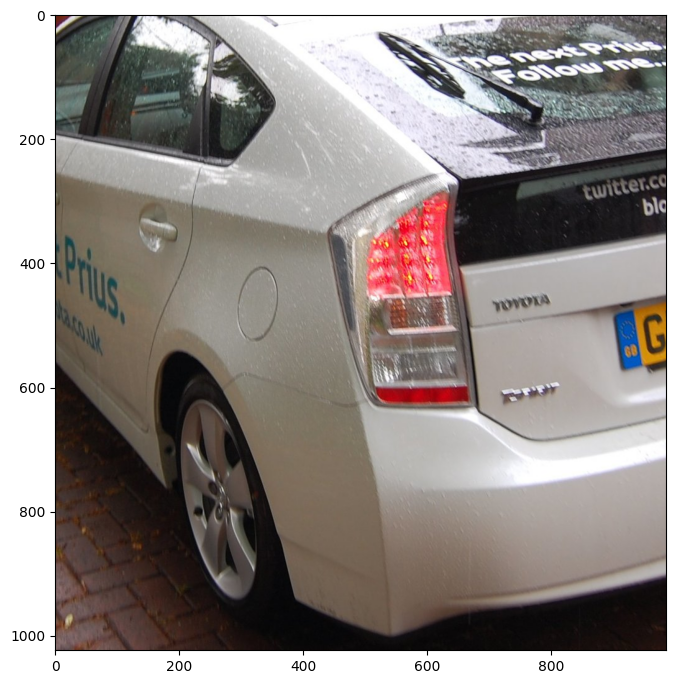

In [ ]:
display_images(validation_label_path, validation_image_path, 3)

In [ ]:
attr = {
    'path' : root_dir,
    'train' : root_dir + '/Vehicle_Registration_Plate/train/images',
    'val' : root_dir + '/Vehicle_Registration_Plate/validation/images',
    'nc': 1,
    'names' : ['Reg-plate']
}

In [ ]:
with open('vehicle_det.yaml','w') as f:
    yaml.dump(attr, f)

In [ ]:
%load_ext tensorboard
%tensorboard --logdir 'runs/detect/'

<IPython.core.display.Javascript object>

In [ ]:
print(root_dir)

/content/Dataset


In [ ]:
model = YOLO('yolov9c.pt')

model.info()

results = model.train(data = 'vehicle_det.yaml', epochs = 30, imgsz = 640)

100%|██████████| 49.4M/49.4M [00:00<00:00, 125MB/s]


YOLOv9c summary: 358 layers, 25,590,912 parameters, 0 gradients, 104.0 GFLOPs
Ultralytics 8.3.94 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov9c.pt, data=vehicle_det.yaml, epochs=30, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=

100%|██████████| 755k/755k [00:00<00:00, 25.2MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1      1856  ultralytics.nn.modules.conv.Conv             [3, 64, 3, 2]                 
  1                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  2                  -1  1    212864  ultralytics.nn.modules.block.RepNCSPELAN4    [128, 256, 128, 64, 1]        
  3                  -1  1    164352  ultralytics.nn.modules.block.ADown           [256, 256]                    
  4                  -1  1    847616  ultralytics.nn.modules.block.RepNCSPELAN4    [256, 512, 256, 128, 1]       
  5                  -1  1    656384  ultralytics.nn.modules.block.ADown           [512, 512]                    
  6                  -1  1   2857472  ultralytics.nn.modules.block.RepNCSPELAN4    [512, 512, 512, 256, 1]       
  7                  -1  1    656384  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 99.2MB/s]


AMP: checks passed ✅


train: Scanning /content/Dataset/Vehicle_Registration_Plate/train/labels... 5308 images, 0 backgrounds, 0 corrupt: 100%|██████████| 5308/5308 [00:03<00:00, 1596.99it/s]


train: New cache created: /content/Dataset/Vehicle_Registration_Plate/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/Dataset/Vehicle_Registration_Plate/validation/labels... 386 images, 0 backgrounds, 0 corrupt: 100%|██████████| 386/386 [00:00<00:00, 1158.17it/s]

val: New cache created: /content/Dataset/Vehicle_Registration_Plate/validation/labels.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 154 weight(decay=0.0), 161 weight(decay=0.0005), 160 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train
Starting training for 30 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/30      10.3G      1.678       1.69      1.384         31        640: 100%|██████████| 332/332 [04:22<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:06<00:00,  1.93it/s]

                   all        386        512     0.0242     0.0862    0.00502    0.00227



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/30      12.8G      1.758      1.426      1.423         19        640: 100%|██████████| 332/332 [04:23<00:00,  1.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:05<00:00,  2.20it/s]

                   all        386        512      0.682      0.621      0.606      0.341



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/30      12.9G      1.695      1.309      1.362         24        640: 100%|██████████| 332/332 [04:22<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:05<00:00,  2.21it/s]

                   all        386        512      0.812      0.699      0.773       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/30        13G      1.643      1.206      1.319         26        640: 100%|██████████| 332/332 [04:21<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:05<00:00,  2.22it/s]

                   all        386        512      0.847      0.712      0.778      0.508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/30      13.1G      1.599      1.138      1.308         31        640: 100%|██████████| 332/332 [04:21<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:05<00:00,  2.22it/s]

                   all        386        512      0.764      0.713      0.743      0.482



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/30      13.1G      1.554      1.054      1.278         27        640: 100%|██████████| 332/332 [04:20<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:05<00:00,  2.21it/s]

                   all        386        512      0.881      0.771      0.854      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/30      13.2G      1.522      1.011      1.267         24        640: 100%|██████████| 332/332 [04:20<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:05<00:00,  2.22it/s]

                   all        386        512      0.869      0.763       0.83      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/30      13.3G      1.508     0.9708      1.241         26        640: 100%|██████████| 332/332 [04:20<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:05<00:00,  2.22it/s]

                   all        386        512      0.925      0.787      0.872      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/30      10.4G      1.473     0.9339      1.239         23        640: 100%|██████████| 332/332 [04:21<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:05<00:00,  2.22it/s]

                   all        386        512      0.919      0.814      0.869      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/30      12.8G      1.479     0.9115      1.235         31        640: 100%|██████████| 332/332 [04:21<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:05<00:00,  2.22it/s]

                   all        386        512       0.92      0.795      0.876      0.607



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/30      12.9G       1.44     0.8963      1.234         29        640: 100%|██████████| 332/332 [04:20<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:05<00:00,  2.20it/s]

                   all        386        512      0.915      0.811      0.882      0.626



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/30        13G       1.41     0.8663      1.203         32        640: 100%|██████████| 332/332 [04:21<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:05<00:00,  2.21it/s]

                   all        386        512       0.88      0.836      0.877      0.623



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/30        13G      1.393     0.8539      1.196         19        640: 100%|██████████| 332/332 [04:20<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:05<00:00,  2.21it/s]

                   all        386        512      0.886      0.842      0.894      0.621



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/30      13.1G      1.389     0.8344      1.189         24        640: 100%|██████████| 332/332 [04:21<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:05<00:00,  2.22it/s]

                   all        386        512      0.898      0.855      0.894      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/30      13.2G      1.389     0.8369      1.183         30        640: 100%|██████████| 332/332 [04:20<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:05<00:00,  2.20it/s]

                   all        386        512      0.913      0.852      0.903      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/30      13.2G       1.37     0.7916      1.181         35        640: 100%|██████████| 332/332 [04:21<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:05<00:00,  2.20it/s]

                   all        386        512      0.918      0.858        0.9      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/30      10.4G      1.351     0.7815      1.168         24        640: 100%|██████████| 332/332 [04:20<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:05<00:00,  2.22it/s]

                   all        386        512       0.94       0.85      0.909      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/30      12.8G      1.352     0.7962      1.162         32        640: 100%|██████████| 332/332 [04:20<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:05<00:00,  2.22it/s]

                   all        386        512      0.934      0.836      0.897      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/30      12.9G      1.339     0.7641      1.165         27        640: 100%|██████████| 332/332 [04:20<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:05<00:00,  2.21it/s]

                   all        386        512      0.924      0.854      0.907       0.65



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/30      12.9G      1.322     0.7449      1.164         40        640: 100%|██████████| 332/332 [04:20<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:05<00:00,  2.22it/s]

                   all        386        512      0.897      0.882      0.913      0.648


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/30        13G      1.353     0.7401      1.172         14        640: 100%|██████████| 332/332 [04:20<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:05<00:00,  2.21it/s]

                   all        386        512      0.892      0.861      0.899      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/30      13.1G      1.344     0.7172      1.161         15        640: 100%|██████████| 332/332 [04:20<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:05<00:00,  2.22it/s]

                   all        386        512      0.911      0.867      0.918       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/30      13.2G      1.328     0.6964      1.158         14        640: 100%|██████████| 332/332 [04:20<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:05<00:00,  2.22it/s]

                   all        386        512      0.941      0.854      0.908      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/30      13.2G      1.312     0.6898      1.146         18        640: 100%|██████████| 332/332 [04:19<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:05<00:00,  2.22it/s]

                   all        386        512      0.924      0.875      0.911      0.654



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/30      13.3G      1.305     0.6782       1.15         18        640: 100%|██████████| 332/332 [04:20<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:05<00:00,  2.22it/s]

                   all        386        512       0.93      0.865      0.914      0.665



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/30      10.4G      1.284     0.6571       1.14         15        640: 100%|██████████| 332/332 [04:20<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:05<00:00,  2.21it/s]

                   all        386        512      0.912      0.886      0.917      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/30      12.9G      1.282      0.653      1.135         16        640: 100%|██████████| 332/332 [04:20<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:05<00:00,  2.20it/s]

                   all        386        512      0.923      0.866      0.915      0.671



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/30      12.9G      1.268     0.6394      1.131         14        640: 100%|██████████| 332/332 [04:20<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:05<00:00,  2.21it/s]

                   all        386        512       0.92      0.881      0.921      0.681



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/30        13G      1.251     0.6238      1.124         17        640: 100%|██████████| 332/332 [04:20<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:05<00:00,  2.22it/s]

                   all        386        512      0.917      0.893      0.916      0.674



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/30      13.1G      1.235     0.6138      1.116         19        640: 100%|██████████| 332/332 [04:20<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:05<00:00,  2.20it/s]

                   all        386        512      0.926      0.879       0.92       0.69



30 epochs completed in 2.235 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 51.6MB
Optimizer stripped from runs/detect/train/weights/best.pt, 51.6MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.94 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv9c summary (fused): 156 layers, 25,320,019 parameters, 0 gradients, 102.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:06<00:00,  2.15it/s]


                   all        386        512      0.926      0.879       0.92       0.69
Speed: 0.1ms preprocess, 11.6ms inference, 0.0ms loss, 1.0ms postprocess per image
Results saved to runs/detect/train


#  <font style="color:green">3. Inference</font>



In [ ]:
def detect(images):
    result = model(images)

    for i, result in enumerate(result):
        #plot result images
        im_bgr = result.plot()  # BGR-order numpy array
        im_rgb = Image.fromarray(im_bgr[..., ::-1])  # RGB-order PIL image

        plt.axis('off')
        plt.imshow(im_rgb)
        plt.show()
        xyxy = result[0].boxes.xyxy[0]
        x1, y1, x2, y2 = map(float, xyxy)
        cls = int(result[0].boxes.cls[0])
        conf = float(result[0].boxes.conf[0])
        print("x1: ", x1, "y1: ", y1, "x2: ", x2, "y2: ", y2, "cls: ", cls, "conf: ", conf)


0: 640x640 1 Reg-plate, 44.7ms
1: 640x640 1 Reg-plate, 44.7ms
2: 640x640 2 Reg-plates, 44.7ms
Speed: 2.9ms preprocess, 44.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


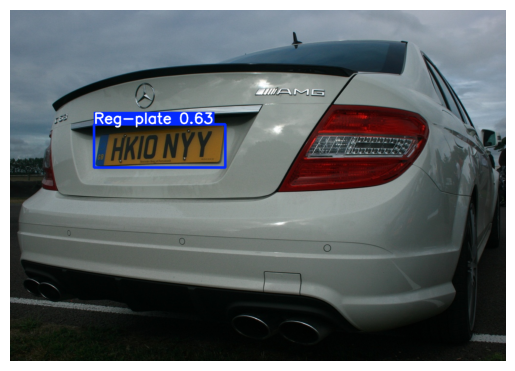

x1:  173.9870147705078 y1:  237.8016815185547 x2:  444.71148681640625 y2:  326.2754821777344 cls:  0 conf:  0.6309536099433899


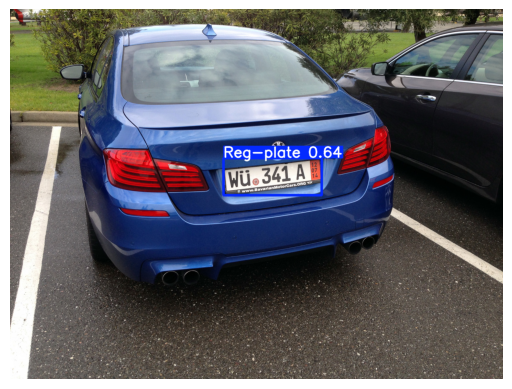

x1:  443.80938720703125 y1:  309.5397033691406 x2:  647.7445678710938 y2:  386.23590087890625 cls:  0 conf:  0.6365576982498169


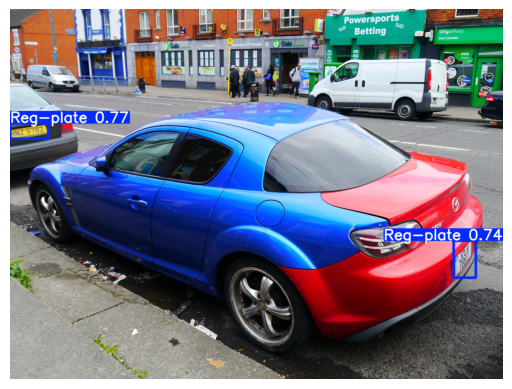

x1:  0.26359865069389343 y1:  237.8388214111328 x2:  79.12276458740234 y2:  269.7404479980469 cls:  0 conf:  0.7686344981193542


In [ ]:
num_samples = 3
test_images = []
for i in range(num_samples):
    im = random.choice(validation_image_names)
    im_path = os.path.join(root_dir, '/Vehicle_Registration_Plate/', validation_image_path)+im+'.jpg'
    test_images.append(im_path)
# print(test_images)
detect(test_images)

#  <font style="color:green">4. COCO Detection Evaluation</font>

For reference here is the coco evaluation metric chart:


---

<img src="https://www.learnopencv.com/wp-content/uploads/2020/03/c3-w9-coco_metric.png">

---


In [ ]:
# Model Validation
metrics = model.val()  # no arguments needed, dataset and settings remembered
print("map ",metrics.box.map)    # map50-95
print("map50 ", metrics.box.map50)  # map50
print("map75 ",metrics.box.map75)  # map75
print("maps50-95 ",metrics.box.maps)   # a list contains map50-95 of each category

Ultralytics 8.3.94 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)


val: Scanning /content/Dataset/Vehicle_Registration_Plate/validation/labels.cache... 386 images, 0 backgrounds, 0 corrupt: 100%|██████████| 386/386 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:10<00:00,  2.36it/s]


                   all        386        512      0.924      0.879      0.918      0.688
Speed: 0.5ms preprocess, 22.8ms inference, 0.0ms loss, 0.7ms postprocess per image
Results saved to runs/detect/train2
map  0.6881700304920099
map50  0.9184385705155789
map75  0.8086742052315866
maps50-95  [    0.68817]


# <font style="color:green">5. Run Inference on a Video</font>

#### [Download the Input Video](https://www.dropbox.com/s/g88o4dx18zpgn8k/projet3-input-video.mp4?dl=1)

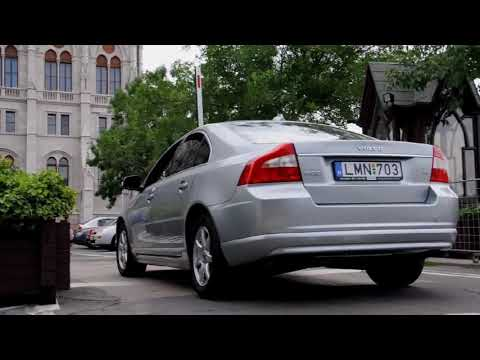

In [ ]:
from IPython.display import YouTubeVideo, display
video = YouTubeVideo("18HWHCevFdU", width=640, height=360)
display(video)

In [ ]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

In [ ]:
pip install pytubefix

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 730.7/730.7 kB 12.6 MB/s eta 0:00:00a 0:00:01


In [ ]:
from pytubefix import YouTube

In [ ]:
# YouTube video URL
video_url = 'https://youtu.be/_aOAo0TCHmY'

# Download the video
yt = YouTube(video_url)
stream = yt.streams.filter(file_extension='mp4').first()
stream.download('/content/Dataset')

'/content/Dataset/Object Detection Before Video.mp4'

In [ ]:
video_path ='/content/Dataset/Object Detection Before Video.mp4'
results = model(video_path, stream=True, save=True)

In [ ]:
for r in results:
    print(r)

Streaming output truncated to the last 5000 lines.
       [[104, 104, 118],
        [145, 145, 159],
        [145, 145, 159],
        ...,
        [ 44,  67,  54],
        [ 44,  67,  54],
        [ 31,  54,  41]],

       ...,

       [[ 79,  70,  74],
        [ 81,  72,  76],
        [ 82,  73,  77],
        ...,
        [149, 144, 150],
        [149, 144, 150],
        [149, 144, 150]],

       [[ 89,  80,  84],
        [ 95,  86,  90],
        [ 99,  90,  94],
        ...,
        [184, 179, 185],
        [183, 178, 184],
        [183, 178, 184]],

       [[ 75,  66,  70],
        [ 82,  73,  77],
        [ 89,  80,  84],
        ...,
        [185, 180, 186],
        [185, 180, 186],
        [185, 180, 186]]], dtype=uint8)
orig_shape: (360, 640)
path: '/content/Dataset/Object Detection Before Video.mp4'
probs: None
save_dir: 'runs/detect/train3'
speed: {'preprocess': 1.3978329989186022, 'inference': 16.586944000664516, 'postprocess': 1.11935999848356}
video 1/1 (frame 52/131) /cont

In [ ]:
for dirname, _, filenames in os.walk('/content/runs'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

/content/runs/detect/train3/Object Detection Before Video.avi
/content/runs/detect/train2/confusion_matrix_normalized.png
/content/runs/detect/train2/val_batch2_pred.jpg
/content/runs/detect/train2/val_batch1_labels.jpg
/content/runs/detect/train2/P_curve.png
/content/runs/detect/train2/val_batch1_pred.jpg
/content/runs/detect/train2/val_batch0_labels.jpg
/content/runs/detect/train2/F1_curve.png
/content/runs/detect/train2/confusion_matrix.png
/content/runs/detect/train2/R_curve.png
/content/runs/detect/train2/val_batch2_labels.jpg
/content/runs/detect/train2/val_batch0_pred.jpg
/content/runs/detect/train2/PR_curve.png
/content/runs/detect/train/train_batch6641.jpg
/content/runs/detect/train/confusion_matrix_normalized.png
/content/runs/detect/train/val_batch2_pred.jpg
/content/runs/detect/train/events.out.tfevents.1742489305.f7d35c4a614f.2987.0
/content/runs/detect/train/train_batch0.jpg
/content/runs/detect/train/val_batch1_labels.jpg
/content/runs/detect/train/P_curve.png
/content/r

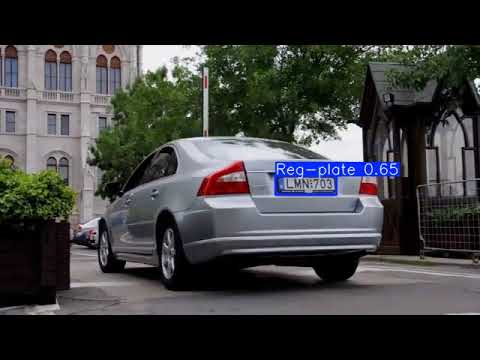

In [ ]:
video = YouTubeVideo("GcFTGHmGbmU", width=640, height=360)
display(video)

In [ ]:
def display_visuals(path):
    image = Image.open(path)
    plt.figure(figsize=(12, 8))
    plt.axis("off")
    plt.imshow(image)
    plt.show()

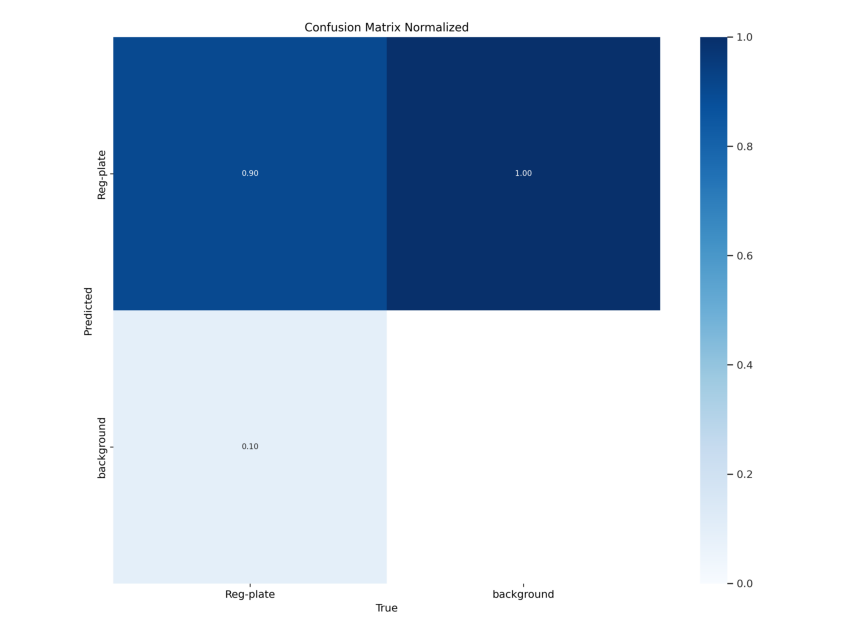

In [ ]:
path = '/content/runs/detect/train2/confusion_matrix_normalized.png'
display_visuals(path)

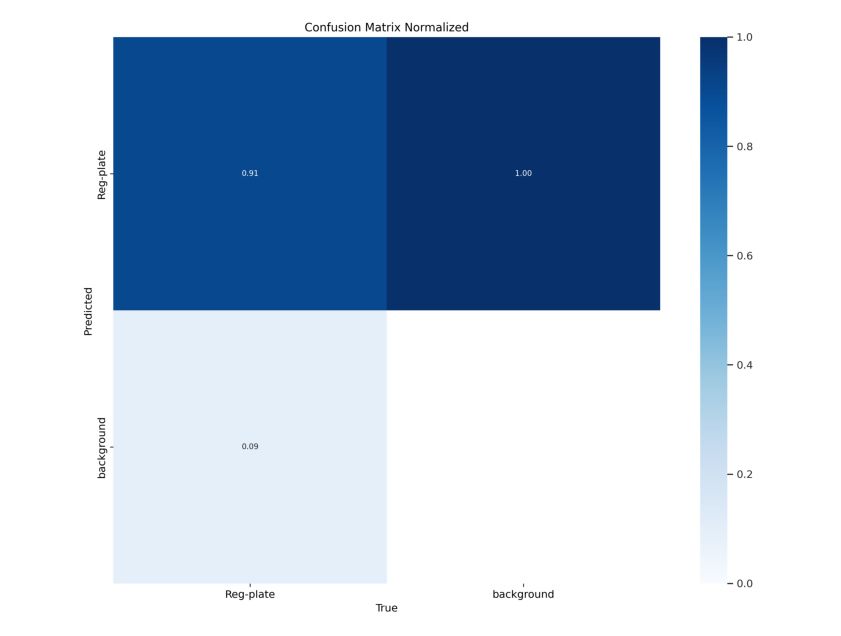

In [ ]:
path = '/content/runs/detect/train/confusion_matrix_normalized.png'
display_visuals(path)

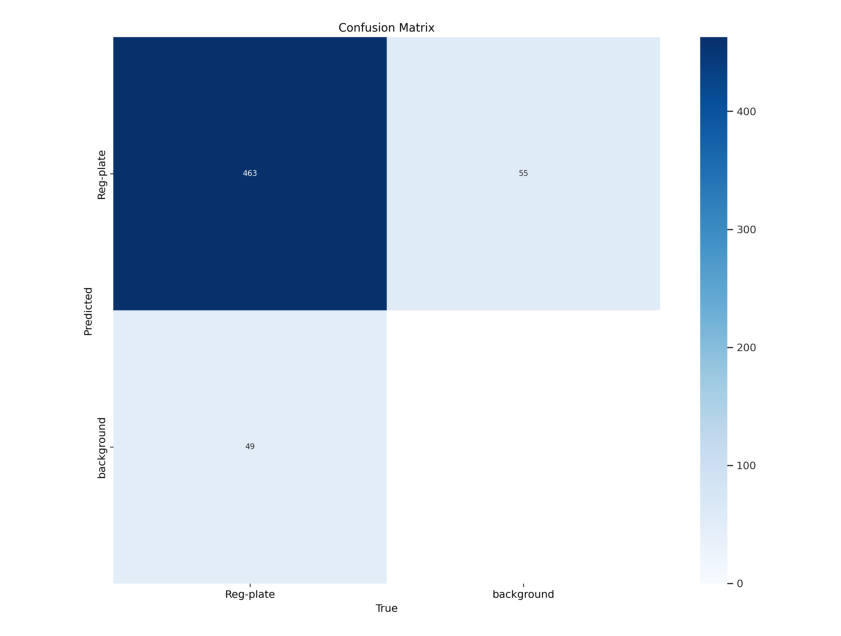

In [ ]:
path = '/content/runs/detect/train2/confusion_matrix.png'
display_visuals(path)

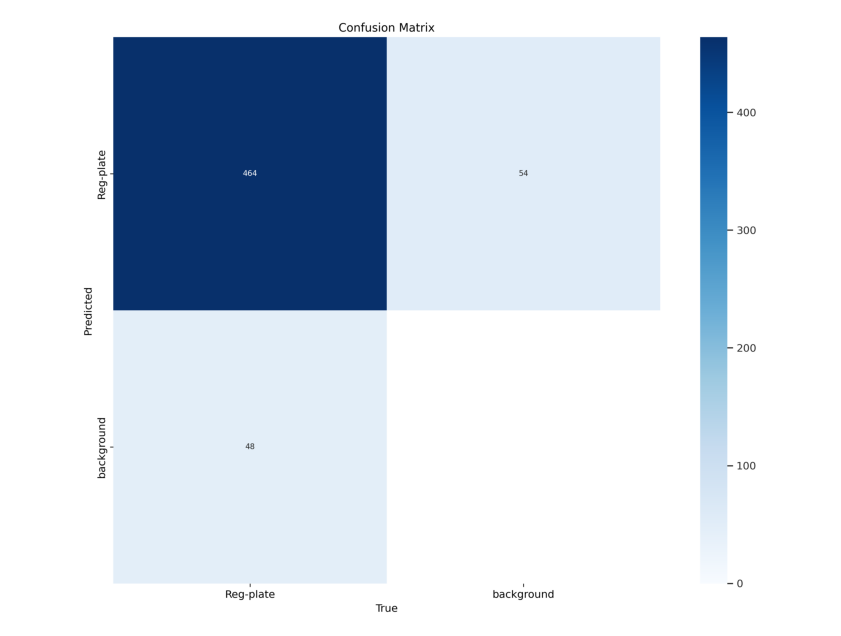

In [ ]:
path = '/content/runs/detect/train/confusion_matrix.png'
display_visuals(path)

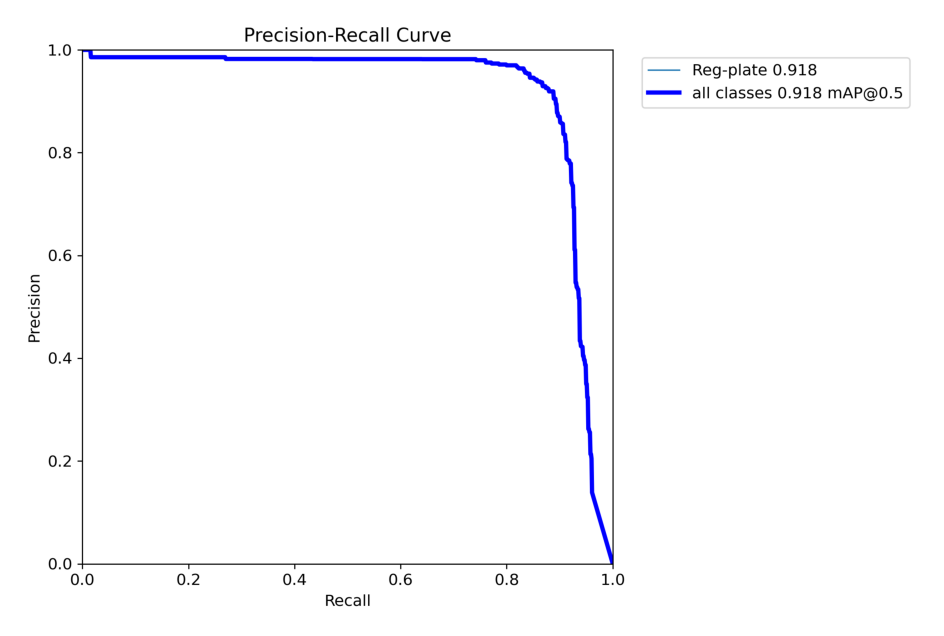

In [ ]:
path = ('/content/runs/detect/train2/PR_curve.png')
display_visuals(path)

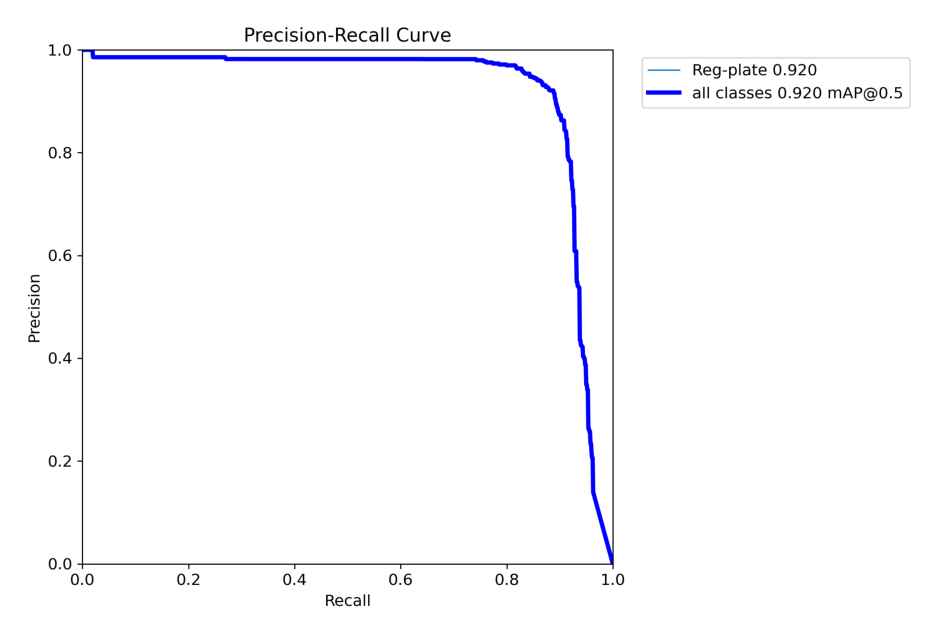

In [ ]:
path = ('/content/runs/detect/train/PR_curve.png')
display_visuals(path)

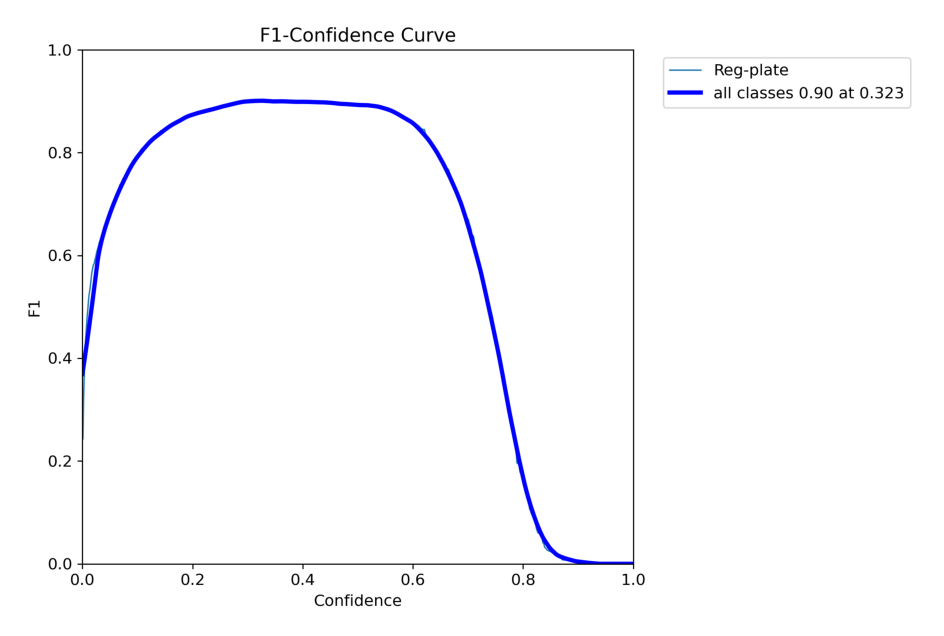

In [ ]:
path = '/content/runs/detect/train2/F1_curve.png'
display_visuals(path)

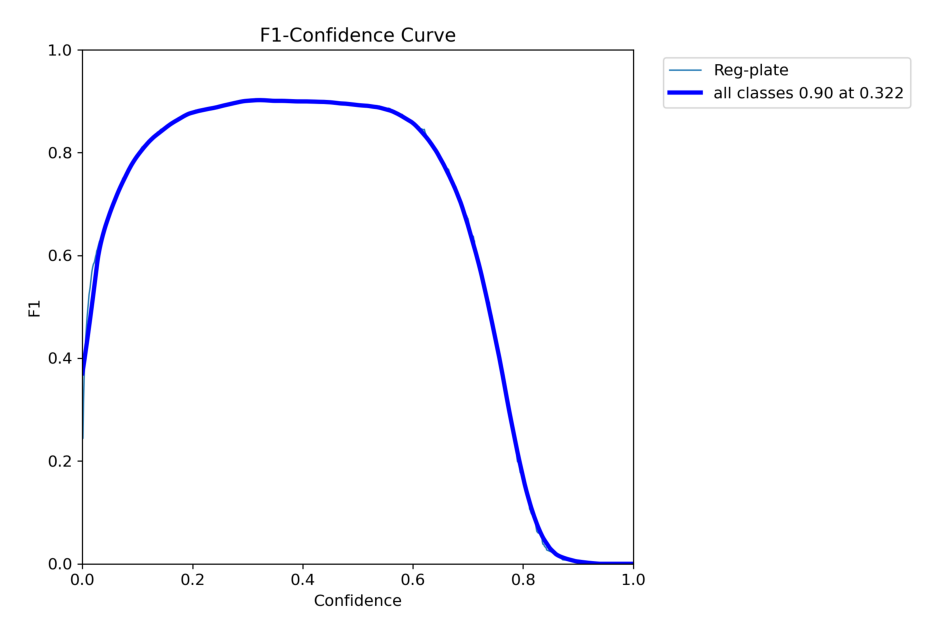

In [ ]:
path = '/content/runs/detect/train/F1_curve.png'
display_visuals(path)

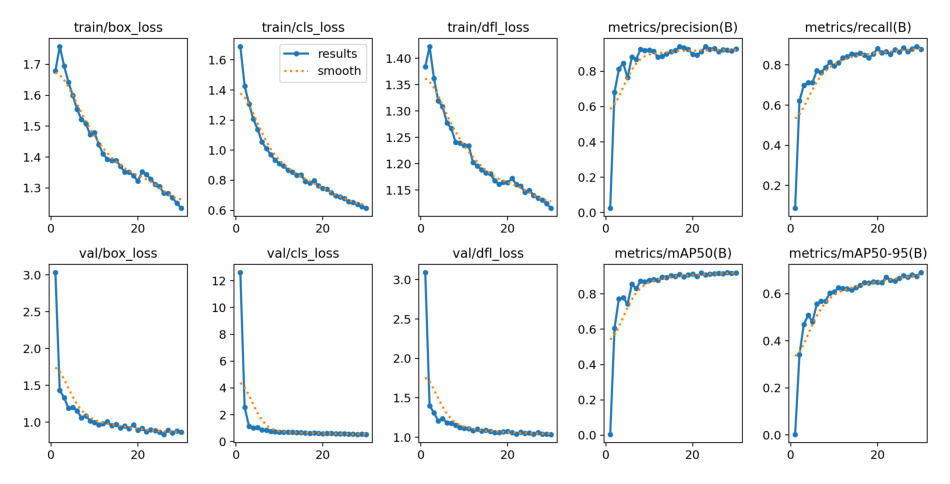

In [ ]:
path = '/content/runs/detect/train/results.png'
display_visuals(path)

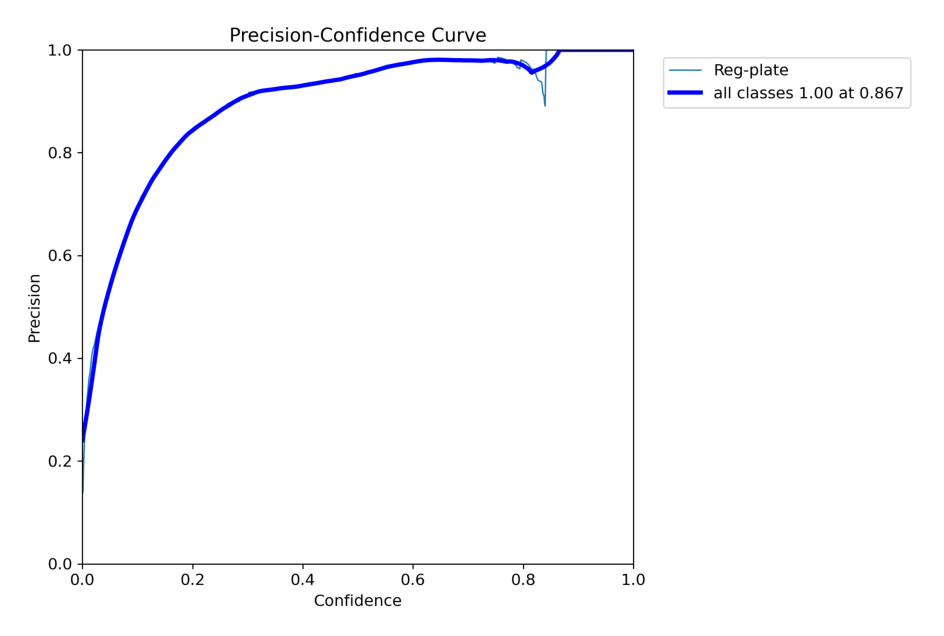

In [ ]:
path = '/content/runs/detect/train2/P_curve.png'
display_visuals(path)

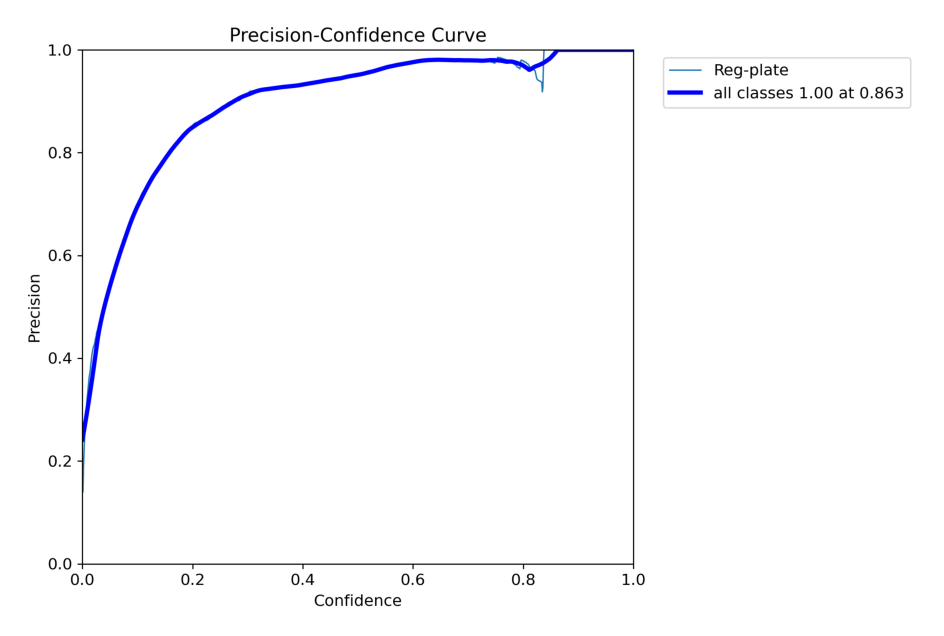

In [ ]:
path = '/content/runs/detect/train/P_curve.png'
display_visuals(path)

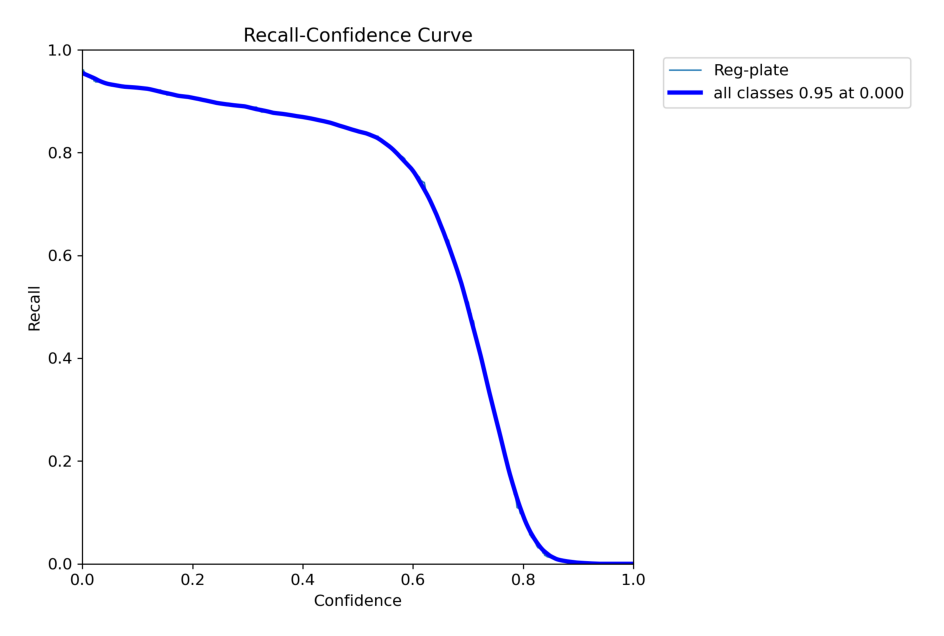

In [ ]:
path = '/content/runs/detect/train2/R_curve.png'
display_visuals(path)

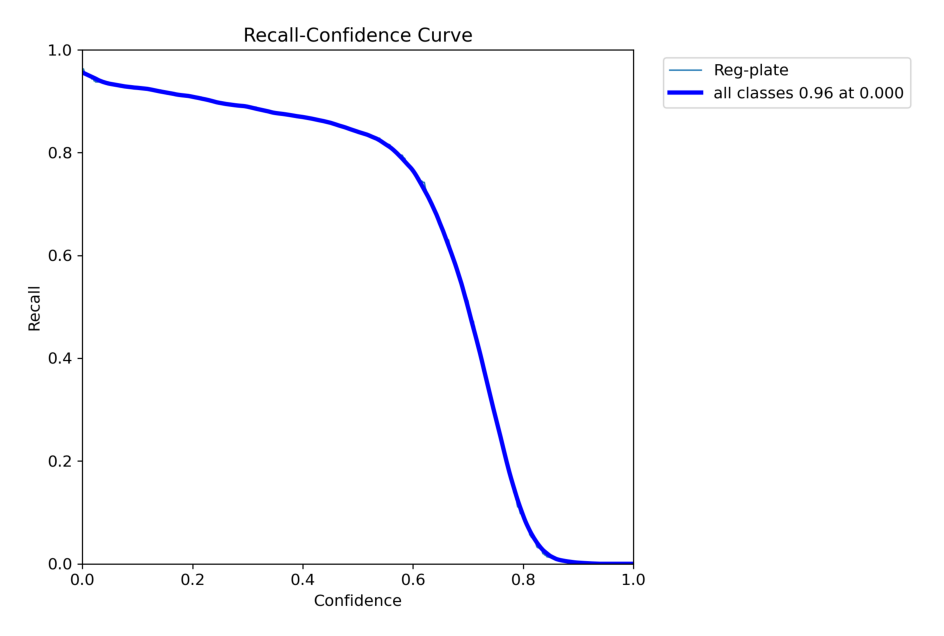

In [ ]:
path = '/content/runs/detect/train/R_curve.png'
display_visuals(path)

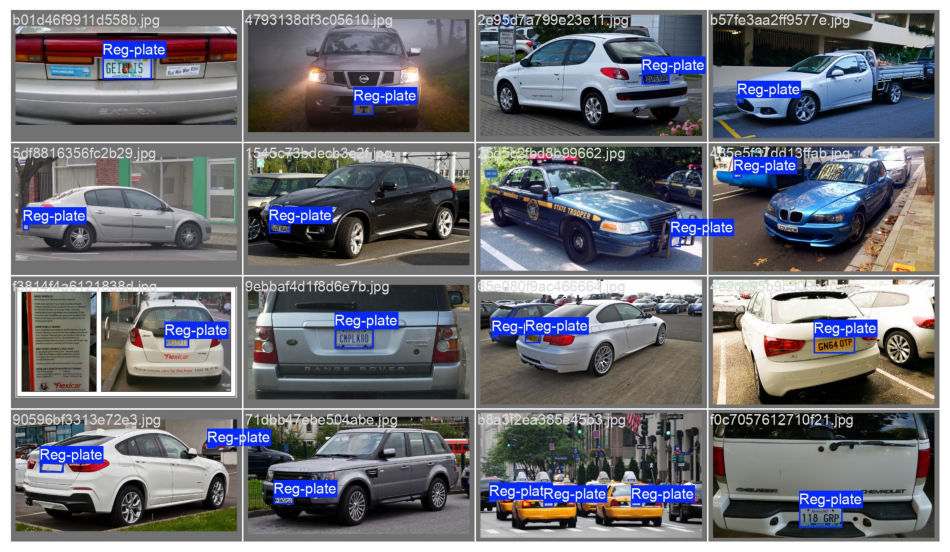

In [ ]:
path = '/content/runs/detect/train2/val_batch0_labels.jpg'
display_visuals(path)

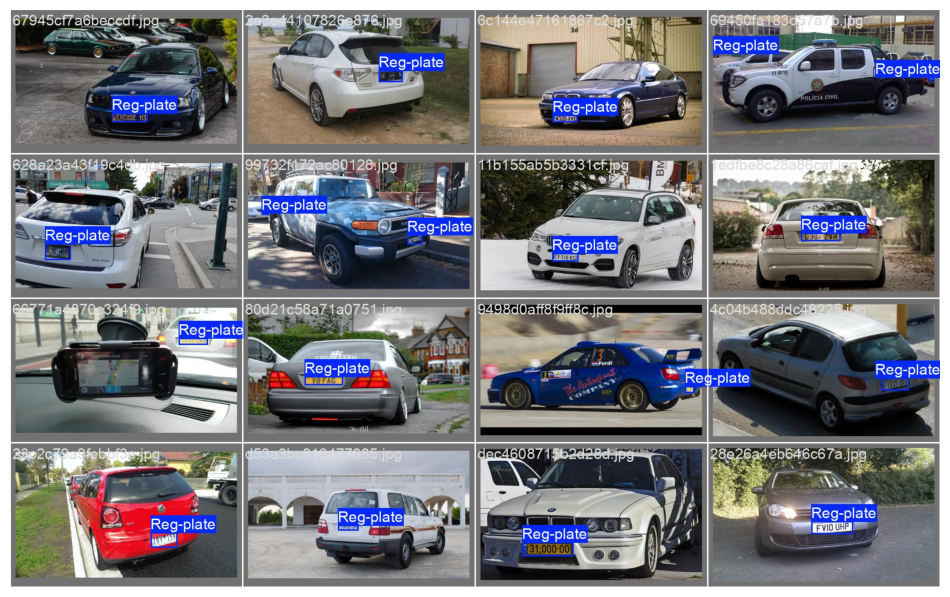

In [ ]:
path = '/content/runs/detect/train2/val_batch1_labels.jpg'
display_visuals(path)

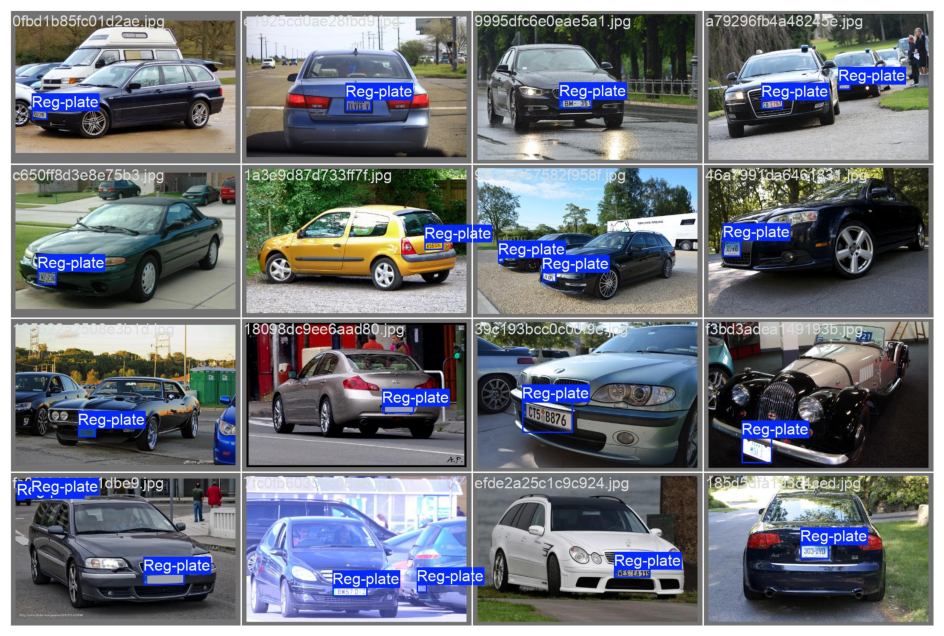

In [ ]:
path = '/content/runs/detect/train2/val_batch2_labels.jpg'
display_visuals(path)

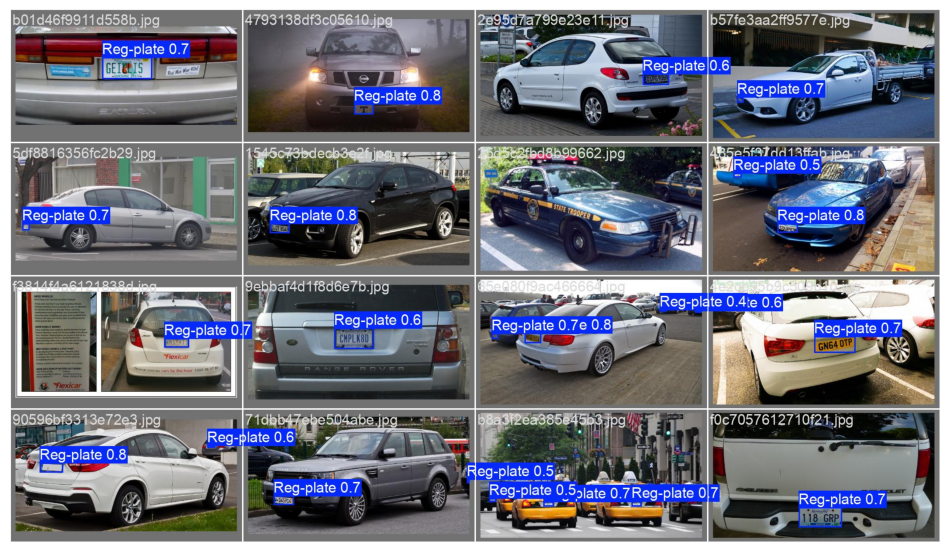

In [ ]:
path = '/content/runs/detect/train2/val_batch0_pred.jpg'
display_visuals(path)

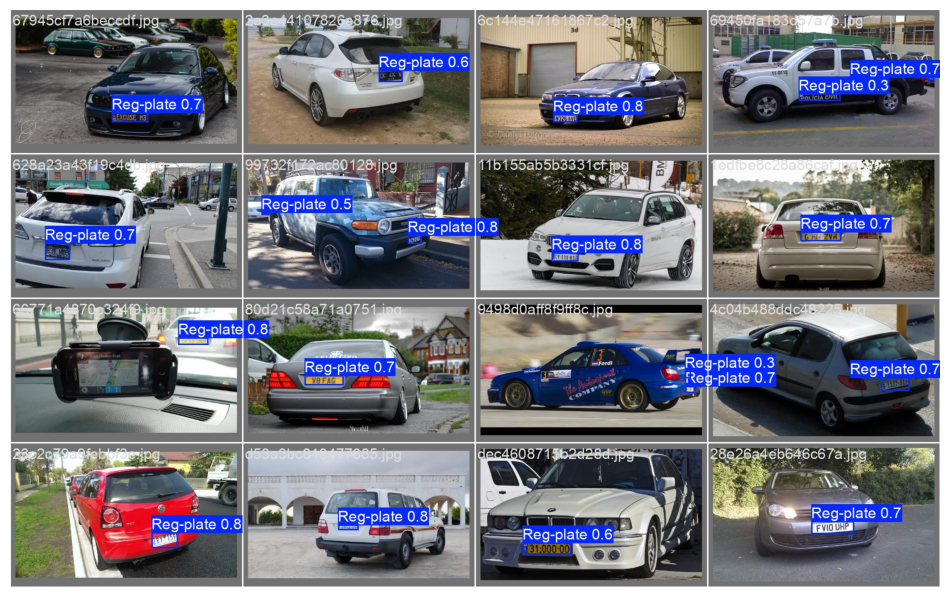

In [ ]:
path = '/content/runs/detect/train2/val_batch1_pred.jpg'
display_visuals(path)

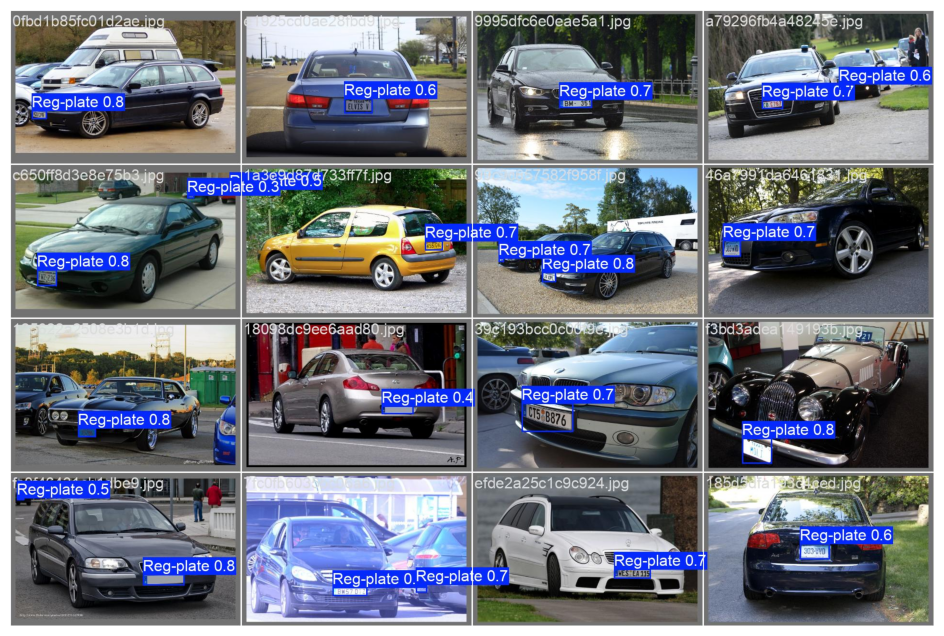

In [ ]:
path = '/content/runs/detect/train2/val_batch2_pred.jpg'
display_visuals(path)

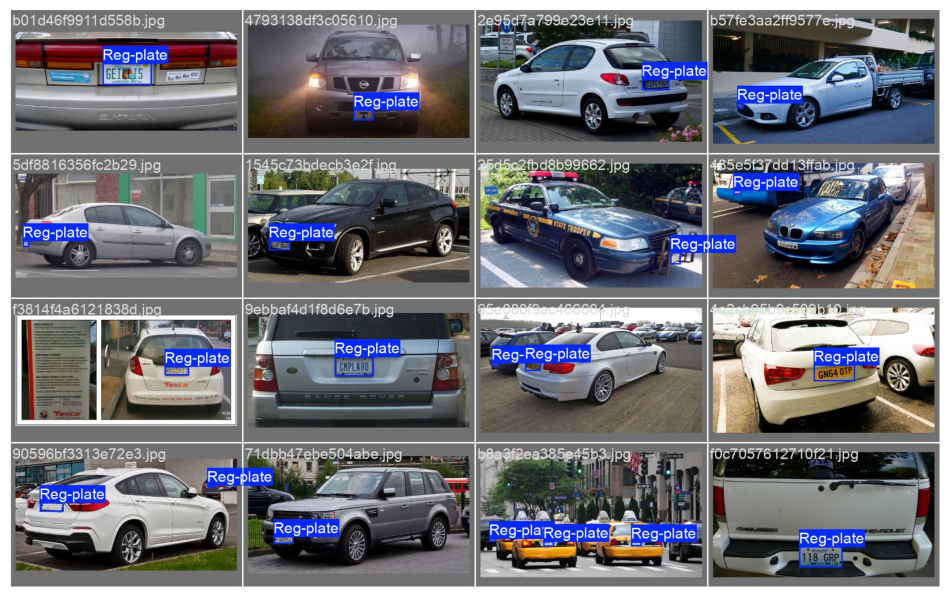

In [ ]:
path = '/content/runs/detect/train/val_batch0_labels.jpg'
display_visuals(path)

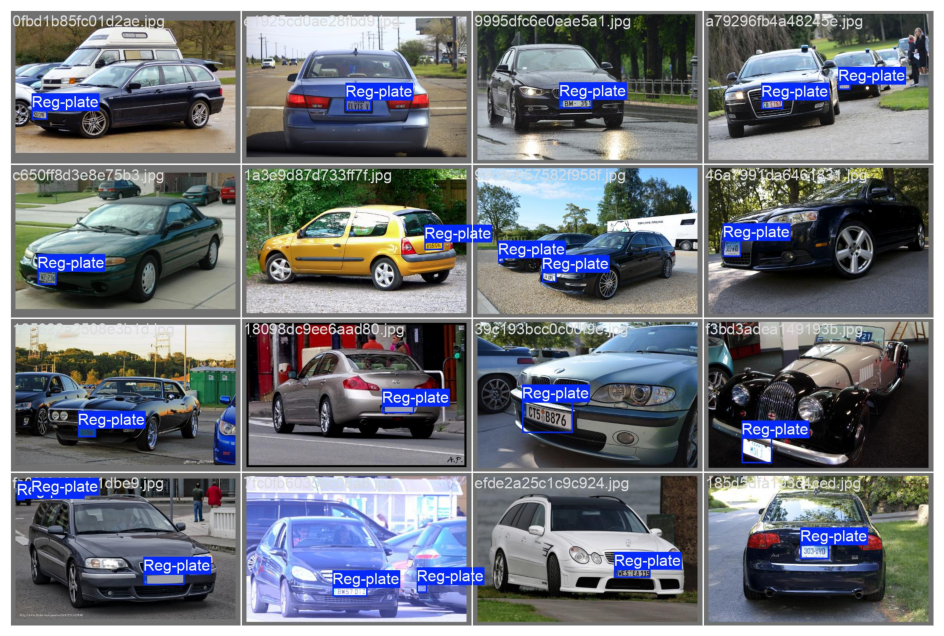

In [ ]:
path = '/content/runs/detect/train/val_batch1_labels.jpg'
display_visuals(path)

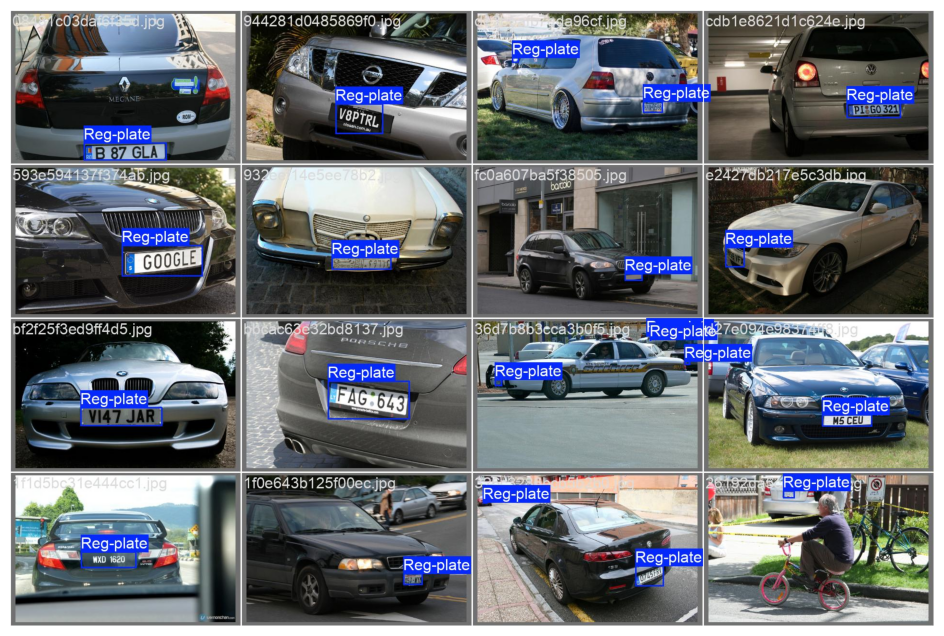

In [ ]:
path = '/content/runs/detect/train/val_batch2_labels.jpg'
display_visuals(path)

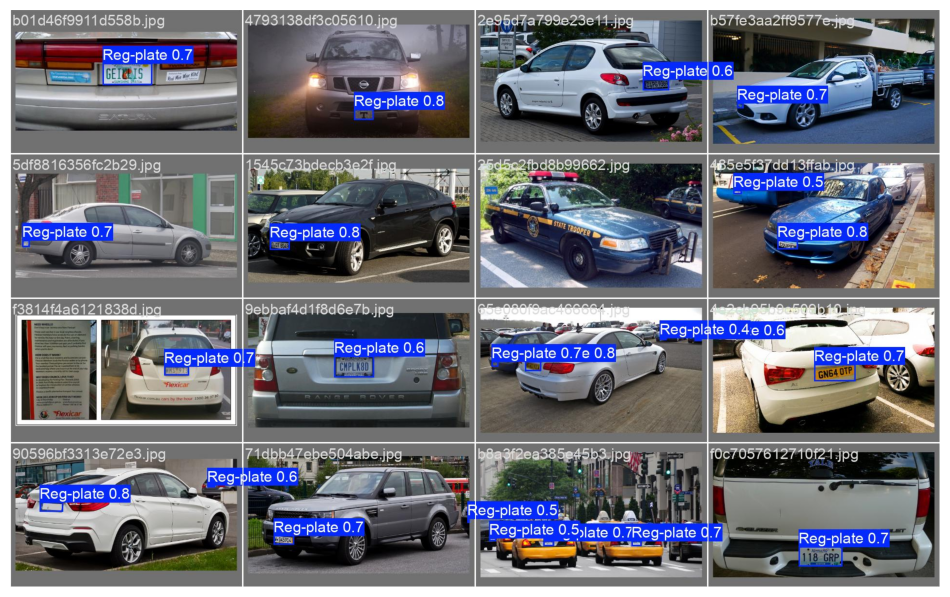

In [ ]:
path = '/content/runs/detect/train/val_batch0_pred.jpg'
display_visuals(path)

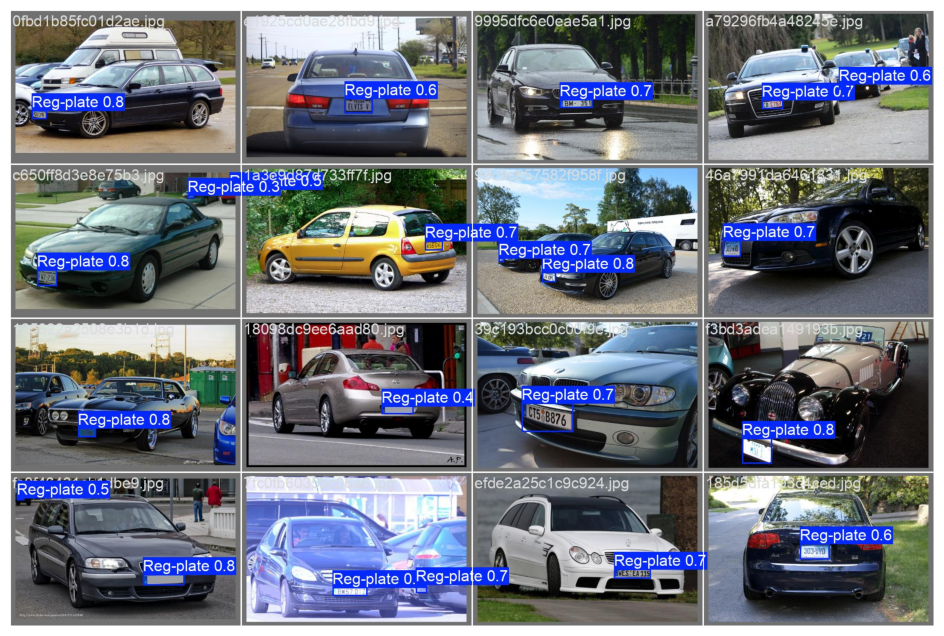

In [ ]:
path = '/content/runs/detect/train/val_batch1_pred.jpg'
display_visuals(path)

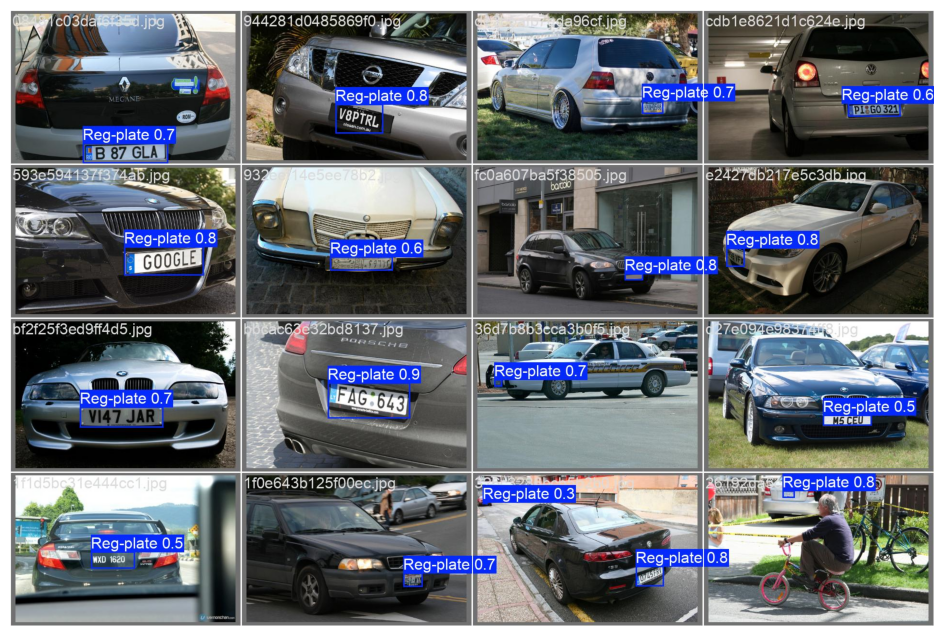

In [ ]:
path = '/content/runs/detect/train/val_batch2_pred.jpg'
display_visuals(path)

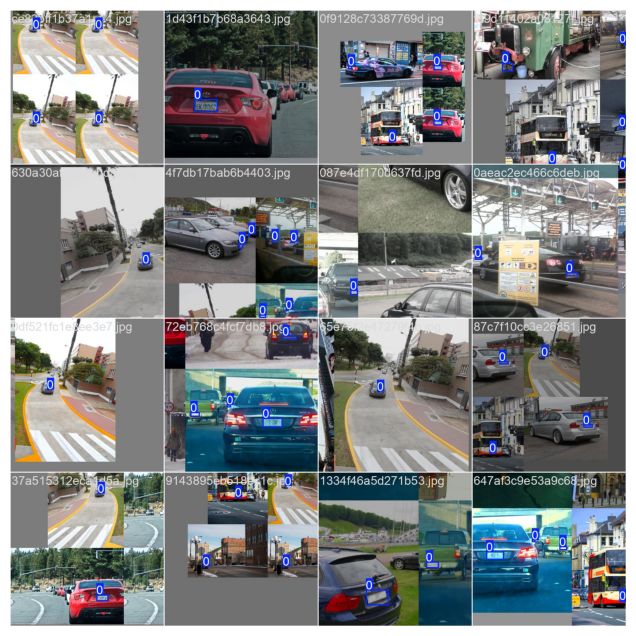

In [ ]:
path = '/content/runs/detect/train/train_batch0.jpg'
display_visuals(path)

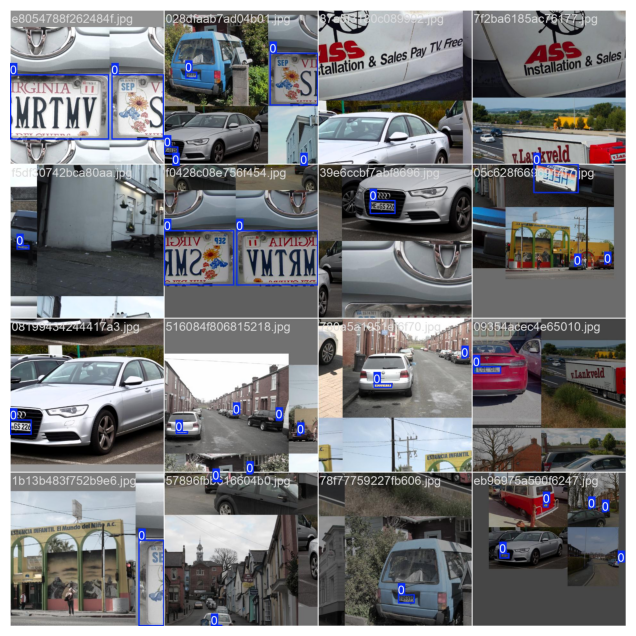

In [ ]:
path = '/content/runs/detect/train/train_batch1.jpg'
display_visuals(path)

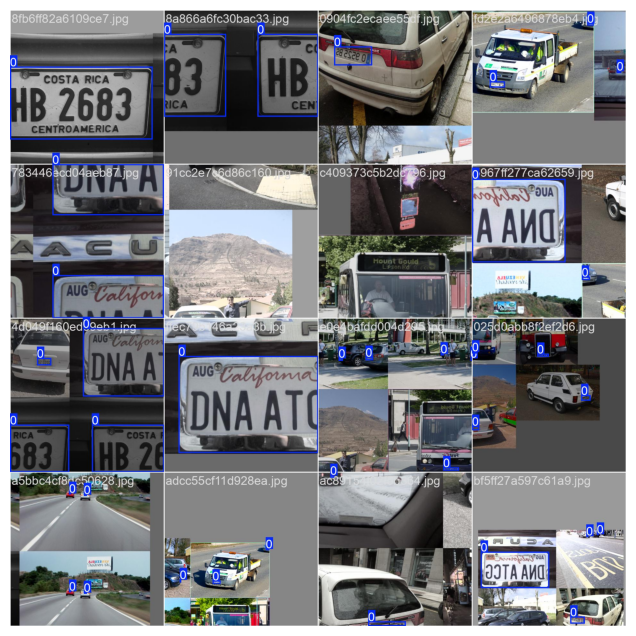

In [ ]:
path = '/content/runs/detect/train/train_batch2.jpg'
display_visuals(path)

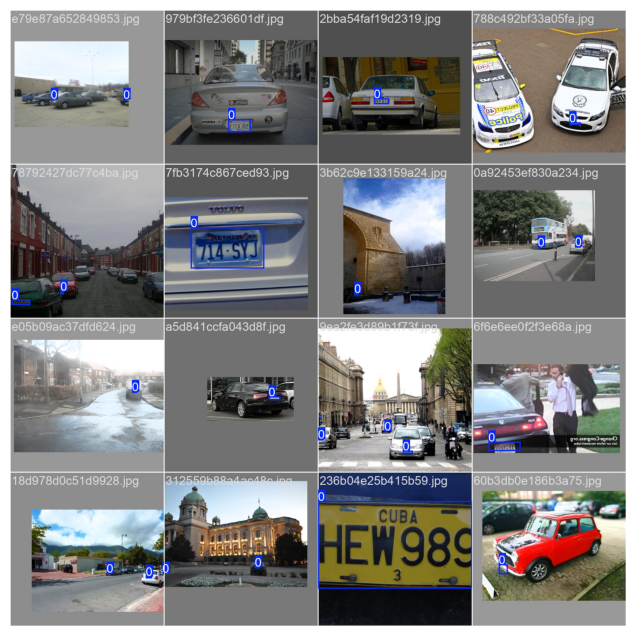

In [ ]:
path = '/content/runs/detect/train/train_batch6640.jpg'
display_visuals(path)

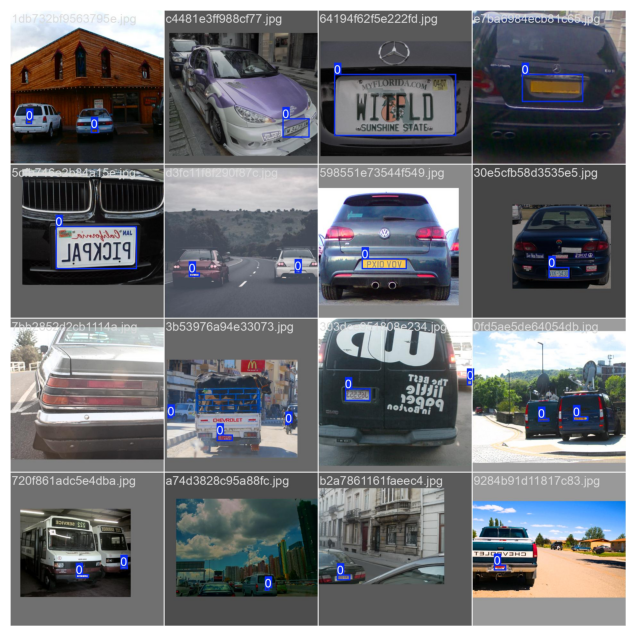

In [ ]:
path = '/content/runs/detect/train/train_batch6641.jpg'
display_visuals(path)

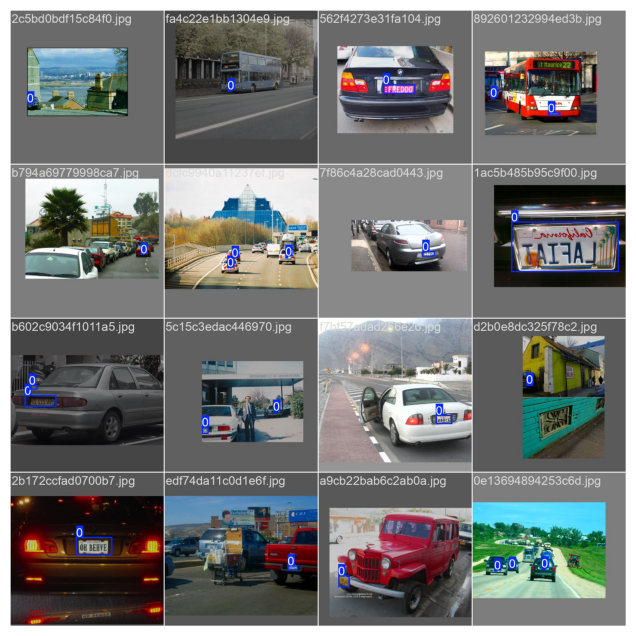

In [ ]:
path = '/content/runs/detect/train/train_batch6642.jpg'
display_visuals(path)

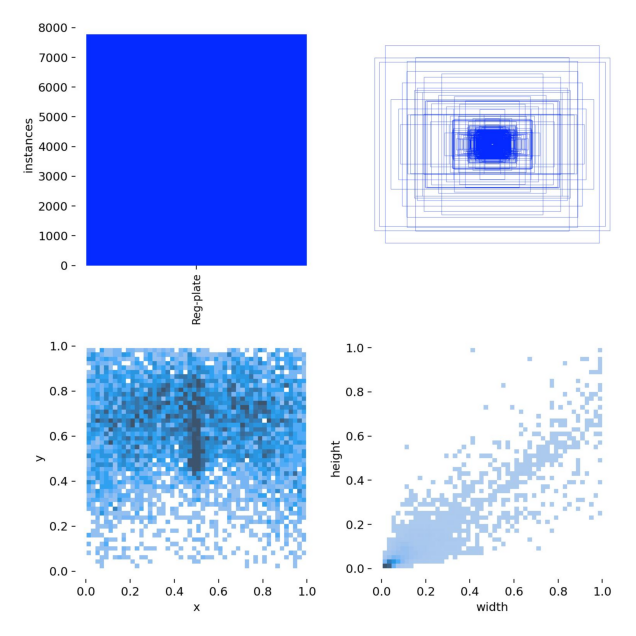

In [ ]:
path = '/content/runs/detect/train/labels.jpg'
display_visuals(path)

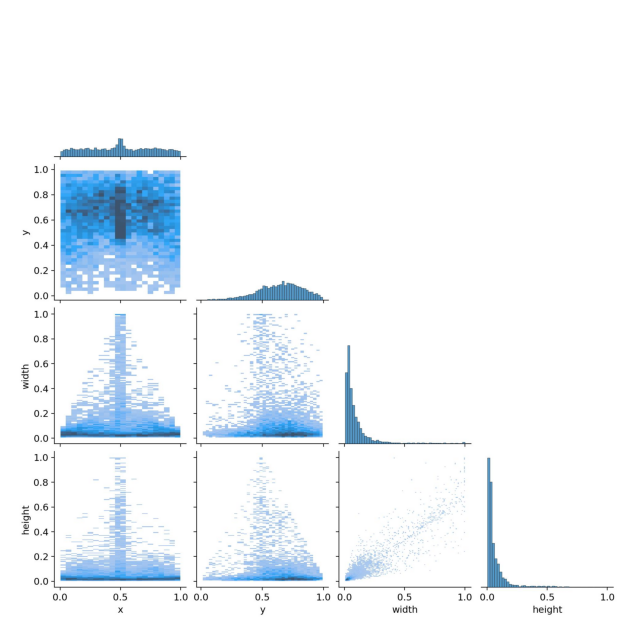

In [ ]:
path = '/content/runs/detect/train/labels_correlogram.jpg'
display_visuals(path)

Here is the link to the output video on my YouTube channel ! : https://youtu.be/GcFTGHmGbmU